<a href="https://colab.research.google.com/github/Mansiphopale/Deep-Learning/blob/main/dl1_perceptron_demo2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from sklearn.datasets import make_classification
import numpy as np

In [ ]:
X, y = make_classification(n_samples=100, n_features=2,
                           n_informative=1,n_redundant=0,
                           n_classes=2, n_clusters_per_class=1,
                           random_state=41,hypercube=False,
                           class_sep=10)

In [ ]:
import matplotlib.pyplot as plt


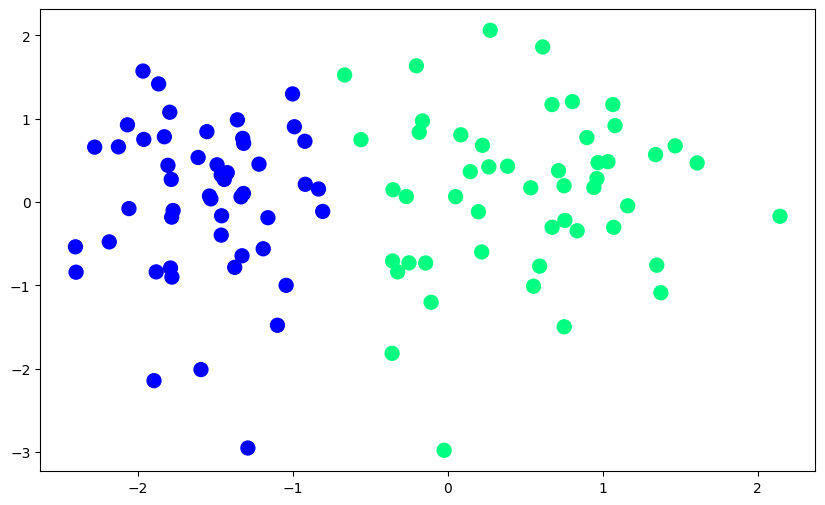

In [ ]:
plt.figure(figsize=(10,6))
plt.scatter(X[:,0],X[:,1],c=y,cmap='winter',s=100)

In [ ]:
def perceptron(X,y):

    X = np.insert(X,0,1,axis=1)
    weights = np.ones(X.shape[1])
    lr = 0.1

    for i in range(1000):
        j = np.random.randint(0,100)
        y_hat = step(np.dot(X[j],weights))
        weights = weights + lr*(y[j]-y_hat)*X[j]

    return weights[0],weights[1:]


In [ ]:
def step(z):
    return 1 if z>0 else 0

In [ ]:
intercept_,coef_ = perceptron(X,y)

In [ ]:
print(coef_)
print(intercept_)

[1.24672407 0.07306628]
1.0


In [ ]:
m = -(coef_[0]/coef_[1])
b = -(intercept_/coef_[1])


In [ ]:

x_input = np.linspace(-3,3,100)
y_input = m*x_input + b

(-3.0, 2.0)

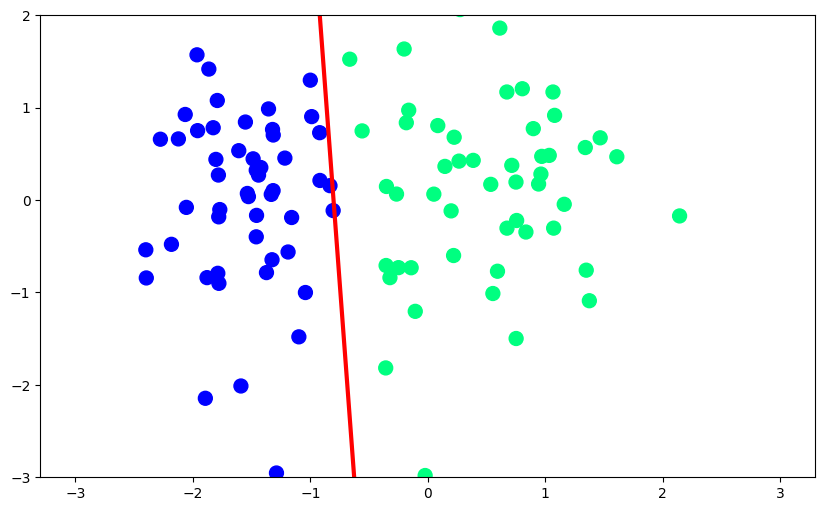

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(x_input,y_input,color='red',linewidth=3)
plt.scatter(X[:,0],X[:,1],c=y,cmap='winter',s=100)
plt.ylim(-3,2)

In [ ]:
def perceptron(X, y):
    m = []
    b = []

    X = np.insert(X, 0, 1, axis=1)
    weights = np.ones(X.shape[1])
    lr = 0.1

    for i in range(200):
        j = np.random.randint(0, 100)
        y_hat = step(np.dot(X[j], weights))
        weights = weights + lr * (y[j] - y_hat) * X[j]

        m.append(-(weights[1] / weights[2]))
        b.append(-(weights / weights[2]))

    return m, b



In [ ]:
m, b = perceptron(X, y)

In [ ]:
# original code for animation
%matplotlib notebook
from matplotlib.animation import FuncAnimation
import matplotlib.animation as animation

fig, ax = plt.subplots(figsize=(9, 5))

x_i = np.arange(-3, 3, 0.1)
y_i = x_i * m[0] + b
ax.scatter(X[:, 0], X[:, 1], c=y, cmap='winter', s=100)
line, = ax.plot(x_i, x_i * m[0] + b, 'r-', linewidth=2)
plt.ylim(-3, 3)
def update(i):
    label = 'epoch {}'.format(i + 1)
    line.set_ydata(x_i * m[i] + b[i])
    ax.set_xlabel(label)
    # return line, ax

anim = FuncAnimation(fig, update, repeat=True, frames=200, interval=100)


<IPython.core.display.Javascript object>

ValueError: operands could not be broadcast together with shapes (60,) (200,3) 

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Example data (replace with your own)
np.random.seed(0)
X = np.random.randn(200, 2)
y = np.random.randint(0, 2, 200)

epochs = 200
m = np.linspace(0.5, 2.0, epochs).reshape(-1, 1)
b = np.linspace(-1.0, 1.0, epochs)

fig, ax = plt.subplots(figsize=(9, 5))
x_i = np.linspace(-3, 3, 60)

ax.scatter(X[:, 0], X[:, 1], c=y, cmap='winter', s=100)
plt.ylim(-3, 3)

(line,) = ax.plot(x_i, x_i * m[0, 0] + b[0], 'r-', linewidth=2)

def update(i):
    y_i = x_i * m[i, 0] + b[i]
    line.set_ydata(y_i)
    ax.set_xlabel(f"epoch {i+1}")
    return line,

anim = FuncAnimation(fig, update, frames=epochs, interval=100, blit=True, repeat=True)

# Show animation in Colab
HTML(anim.to_jshtml())


<IPython.core.display.Javascript object>